# Mount Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Download dataset

In [ ]:
!cp "/content/drive/MyDrive/Colab Notebooks Private/superresolution/train.h5" "/content"

# Check GPU

In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Select the Runtime → "Change runtime type" menu to enable a GPU accelerator, ')
  print('and then re-execute this cell.')
else:
  print(gpu_info)

Sat May  1 15:17:52 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 465.19.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   40C    P0    29W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Imports

In [ ]:
import h5py
import gc
from glob import glob
import numpy as np
from matplotlib import pylab as plt
import cv2
import tensorflow as tf
print(tf.__version__)
from  tensorflow.keras.layers import *
from tensorflow.keras.initializers import *
from tensorflow.keras.optimizers import *
from tensorflow.keras.models import Model
from skimage import exposure
from sklearn.preprocessing import StandardScaler
import time
import os
import joblib
from numba import cuda 
from matplotlib import pyplot

2.4.1


In [ ]:
def load_dataset(dataset, read_only=False):
    if read_only:
        dataset = h5py.File(dataset, 'r')
    else:
        dataset = h5py.File(dataset, 'r+')
    x_data = dataset["x"]
    y_data = dataset["y"]
    return x_data, y_data

In [ ]:
X, y = load_dataset('train.h5', read_only=True)
X.shape, y.shape

((9245, 256, 256, 6), (9245, 256, 256, 6))

In [ ]:
def contrast(image):
    for band_idx in range(image.shape[-1]):
        band_data = image[:,:,band_idx]
        valid_data = band_data[np.logical_and(band_data != np.inf, band_data != -np.inf)]
        in_low, in_high = np.percentile(valid_data, (2, 98))
        
        band_data = exposure.rescale_intensity(band_data, in_range=(in_low, in_high))
        image[:,:,band_idx] = band_data
        
    return image

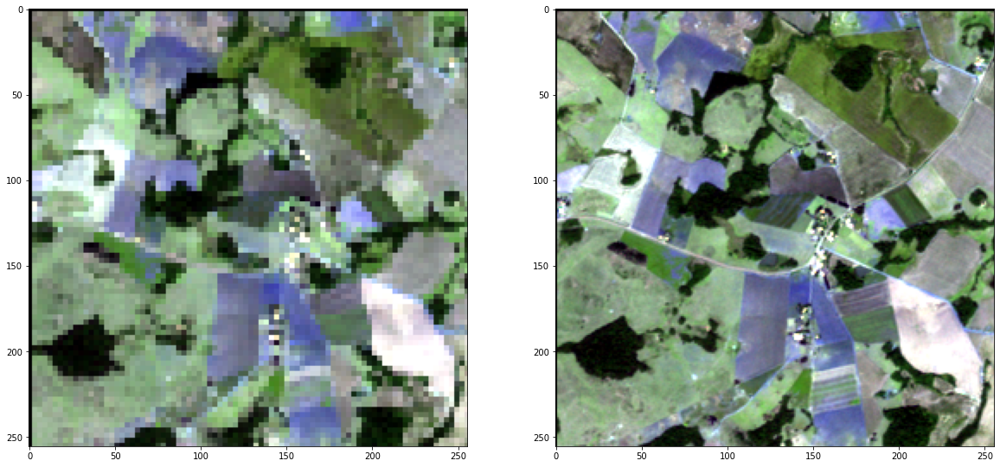

In [ ]:
fig, axs = plt.subplots(1, 2, figsize=(20, 15))

axs[0].imshow(contrast(X[0][:,:, :3] / 10000))
axs[1].imshow(contrast(y[0][:,:, :3] / 10000))

In [ ]:
def load_data(batch_size):
    i=np.random.randint(0,int(len(X)/batch_size))
    
    img_A=(np.array(X[i:i+batch_size]) / 5000.0) - 1
    img_B=(np.array(y[i:i+batch_size]) / 5000.0) - 1

    return img_A,img_B

def load_batch(batch_size):
    
    for i in range(int(len(X)/batch_size)):
        img_A=(X[i:i+batch_size] / 5000.0) - 1
        img_B=(y[i:i+batch_size] / 5000.0) - 1

        yield img_A,img_B

# Define descriminator

In [ ]:
def define_discriminator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    
    # source image input
    in_src_image = Input(shape=image_shape)
    
    # target image input
    in_target_image = Input(shape=image_shape)

    # concatenate images channel-wise
    merged = Concatenate()([in_src_image, in_target_image])
    
    # C64
    d = Conv2D(64, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(merged)
    d = LeakyReLU(alpha=0.2)(d)

    # C128
    d = Conv2D(128, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)

    # C256
    d = Conv2D(256, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)

    # C512
    d = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)

    # second last output layer
    d = Conv2D(512, (4,4), padding='same', kernel_initializer=init)(d)
    d = BatchNormalization()(d)
    d = LeakyReLU(alpha=0.2)(d)

    # patch output
    d = Conv2D(1, (4,4), padding='same', kernel_initializer=init)(d)
    patch_out = Activation('sigmoid')(d)

    # define model
    model = Model([in_src_image, in_target_image], patch_out)
    
    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss='binary_crossentropy', optimizer=opt, loss_weights=[0.5])
    return model

# Define generator

In [ ]:
def define_encoder_block(layer_in, n_filters, batchnorm=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)

    # add downsampling layer
    g = Conv2D(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)

    # conditionally add batch normalization
    if batchnorm:
        g = BatchNormalization()(g, training=True)

    # leaky relu activation
    g = LeakyReLU(alpha=0.2)(g)
    return g

# define a decoder block
def decoder_block(layer_in, skip_in, n_filters, dropout=True):
    # weight initialization
    init = RandomNormal(stddev=0.02)

    # add upsampling layer
    g = Conv2DTranspose(n_filters, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(layer_in)

    # add batch normalization
    g = BatchNormalization()(g, training=True)

    # conditionally add dropout
    if dropout:
        g = Dropout(0.5)(g, training=True)

    # merge with skip connection
    g = Concatenate()([g, skip_in])

    # relu activation
    g = Activation('relu')(g)
    return g

# define the standalone generator model
def define_generator(image_shape):
    # weight initialization
    init = RandomNormal(stddev=0.02)
    # image input
    in_image = Input(shape=image_shape)
    # encoder model
    e1 = define_encoder_block(in_image, 64, batchnorm=False)
    e2 = define_encoder_block(e1, 128)
    e3 = define_encoder_block(e2, 256)
    e4 = define_encoder_block(e3, 512)
    e5 = define_encoder_block(e4, 512)
    e6 = define_encoder_block(e5, 512)
    e7 = define_encoder_block(e6, 512)
    # bottleneck, no batch norm and relu
    b = Conv2D(512, (4,4), strides=(2,2), padding='same', kernel_initializer=init)(e7)
    b = Activation('relu')(b)
    # decoder model
    d1 = decoder_block(b, e7, 512)
    d2 = decoder_block(d1, e6, 512)
    d3 = decoder_block(d2, e5, 512)
    d4 = decoder_block(d3, e4, 512, dropout=False)
    d5 = decoder_block(d4, e3, 256, dropout=False)
    d6 = decoder_block(d5, e2, 128, dropout=False)
    d7 = decoder_block(d6, e1, 64, dropout=False)
    # output
    g = Conv2DTranspose(image_shape[-1], (4,4), strides=(2,2), padding='same', kernel_initializer=init)(d7)
    out_image = Activation('tanh')(g)
    # define model
    model = Model(in_image, out_image)
    return model

# Define GAN

In [ ]:
def define_gan(g_model, d_model, image_shape):
    # make weights in the discriminator not trainable
    for layer in d_model.layers:
        if not isinstance(layer, BatchNormalization):
            layer.trainable = False

    # define the source image
    in_src = Input(shape=image_shape)

    # connect the source image to the generator input
    gen_out = g_model(in_src)

    # connect the source input and generator output to the discriminator input
    dis_out = d_model([in_src, gen_out])

    # src image as input, generated image and classification output
    model = Model(in_src, [dis_out, gen_out])

    # compile model
    opt = Adam(lr=0.0002, beta_1=0.5)
    model.compile(loss=['binary_crossentropy', 'mae'], optimizer=opt, loss_weights=[1,100])
    return model

# Generate Real Samples

In [ ]:
# select a batch of random samples, returns images and target
def generate_real_samples(n_samples, patch_shape):
    # unpack dataset
    trainA, trainB = load_data(n_samples)
    # choose random instances
    ix = np.random.randint(0, trainA.shape[0], n_samples)
    # retrieve selected images
    X1, X2 = trainA[ix], trainB[ix]
    # generate 'real' class labels (1)
    y = np.ones((n_samples, patch_shape, patch_shape, 1))
    return [X1, X2], y

# Generate fake samples

In [ ]:
# generate a batch of images, returns images and targets
def generate_fake_samples(g_model, samples, patch_shape):
    # generate fake instance
    X = g_model.predict(samples)
    # create 'fake' class labels (0)
    y = np.zeros((len(X), patch_shape, patch_shape, 1))
    return X, y

# Sumarize performance

In [ ]:
def summarize_performance(step, g_model, logs_dir, n_samples):
    r, c = 3, n_samples
    
    # select a sample of input images
    [X_realA, X_realB], _ = generate_real_samples(n_samples, 1)
    
    # generate a batch of fake samples
    X_fakeB, _ = generate_fake_samples(g_model, X_realA, 1)
    
    gen_imgs = np.concatenate([X_realA, X_fakeB, X_realB])

    titles = ['Condition', 'Generated', 'Original']
    fig, axs = plt.subplots(r, c, figsize=(20,20))
    cnt = 0
    for i in range(r):
        for j in range(c):
            image = gen_imgs[cnt]

            reescaled_image = (image + 1) * 5000

            rgb_image = reescaled_image[:,:, :3]

            axs[i,j].imshow(contrast(rgb_image/10000))
            axs[i,j].set_title(titles[i])
            axs[i,j].axis('off')
            cnt += 1
            
    filename = '%s/plot_%06d.png' % (logs_dir, step)
    fig.savefig(filename)
    plt.show()

# Train model

In [ ]:
# train pix2pix model
def train(d_model, g_model, gan_model, n_epochs, n_batch, logs_dir, d_filename, g_filename):
    
    # determine the output square shape of the discriminator
    n_patch = d_model.output_shape[1]
    
    # unpack dataset
    for epoch in range(1, n_epochs + 1):
        for batch_i,(trainA,trainB) in enumerate(load_batch(n_batch)):
            
            # select a batch of real samples
            [X_realA, X_realB], y_real = generate_real_samples(n_batch, n_patch)

            # generate a batch of fake samples
            X_fakeB, y_fake = generate_fake_samples(g_model, X_realA, n_patch)
            
            # update discriminator for real samples
            d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_real)
            
            # update discriminator for generated samples
            d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fake)
            
            # update the generator
            g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_real, X_realB])
            
            # summarize performance
            print('[Epoch %d] [Batch %d] [D1 loss: %f] [D2 loss: %f] [G loss: %f]' % (epoch, batch_i, d_loss1, d_loss2, g_loss))
        
        # summarize model performance
        summarize_performance(epoch, g_model, logs_dir, n_samples=3)
        
        # save the generator model
        g_model.save(d_filename)

        # save the discriminator model        
        d_model.save(g_filename)

[Epoch 1] [Batch 0] [D1 loss: 0.480932] [D2 loss: 0.600531] [G loss: 71.866699]
[Epoch 1] [Batch 1] [D1 loss: 0.347461] [D2 loss: 0.510116] [G loss: 68.669907]
[Epoch 1] [Batch 2] [D1 loss: 0.410870] [D2 loss: 0.506158] [G loss: 66.426353]
[Epoch 1] [Batch 3] [D1 loss: 0.211046] [D2 loss: 0.460339] [G loss: 64.127960]
[Epoch 1] [Batch 4] [D1 loss: 0.086869] [D2 loss: 0.310668] [G loss: 62.356186]
[Epoch 1] [Batch 5] [D1 loss: 0.068802] [D2 loss: 0.186278] [G loss: 60.154160]
[Epoch 1] [Batch 6] [D1 loss: 0.047872] [D2 loss: 0.121942] [G loss: 57.359085]
[Epoch 1] [Batch 7] [D1 loss: 0.046941] [D2 loss: 0.081033] [G loss: 54.444084]
[Epoch 1] [Batch 8] [D1 loss: 0.030751] [D2 loss: 0.067502] [G loss: 51.732327]
[Epoch 1] [Batch 9] [D1 loss: 0.026424] [D2 loss: 0.047676] [G loss: 49.834251]
[Epoch 1] [Batch 10] [D1 loss: 0.023550] [D2 loss: 0.038116] [G loss: 47.308586]
[Epoch 1] [Batch 11] [D1 loss: 0.019693] [D2 loss: 0.033888] [G loss: 45.291069]
[Epoch 1] [Batch 12] [D1 loss: 0.01943

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


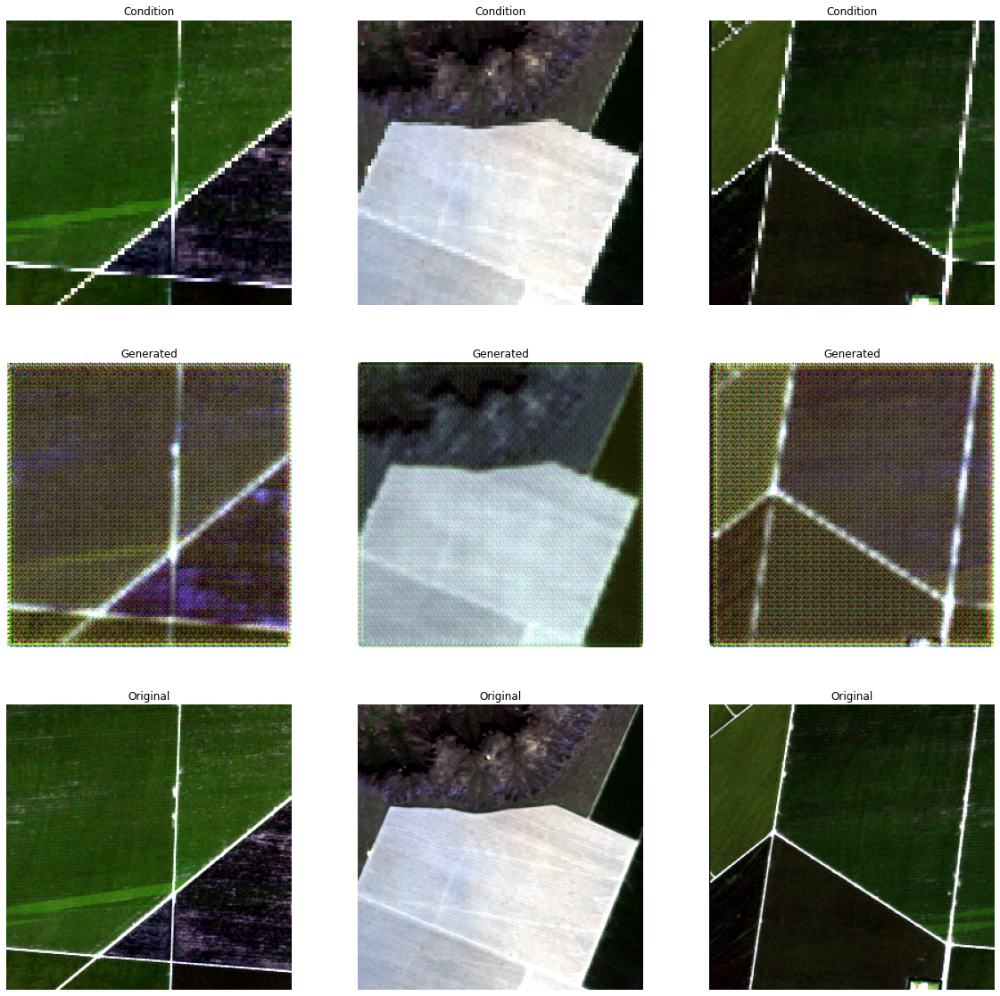

[Epoch 2] [Batch 0] [D1 loss: 0.177892] [D2 loss: 0.632719] [G loss: 4.387995]
[Epoch 2] [Batch 1] [D1 loss: 0.807577] [D2 loss: 0.102421] [G loss: 4.058659]
[Epoch 2] [Batch 2] [D1 loss: 0.310147] [D2 loss: 0.217707] [G loss: 4.022371]
[Epoch 2] [Batch 3] [D1 loss: 0.253151] [D2 loss: 1.015261] [G loss: 3.379651]
[Epoch 2] [Batch 4] [D1 loss: 0.432004] [D2 loss: 0.485904] [G loss: 3.510570]
[Epoch 2] [Batch 5] [D1 loss: 0.511399] [D2 loss: 0.262663] [G loss: 3.190679]
[Epoch 2] [Batch 6] [D1 loss: 0.373896] [D2 loss: 0.313974] [G loss: 3.728224]
[Epoch 2] [Batch 7] [D1 loss: 0.203307] [D2 loss: 0.439846] [G loss: 3.087680]
[Epoch 2] [Batch 8] [D1 loss: 0.373777] [D2 loss: 0.136649] [G loss: 4.487164]
[Epoch 2] [Batch 9] [D1 loss: 0.228393] [D2 loss: 0.152730] [G loss: 4.283529]
[Epoch 2] [Batch 10] [D1 loss: 0.097309] [D2 loss: 0.205886] [G loss: 4.083172]
[Epoch 2] [Batch 11] [D1 loss: 0.079963] [D2 loss: 0.592744] [G loss: 3.881464]
[Epoch 2] [Batch 12] [D1 loss: 0.639121] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


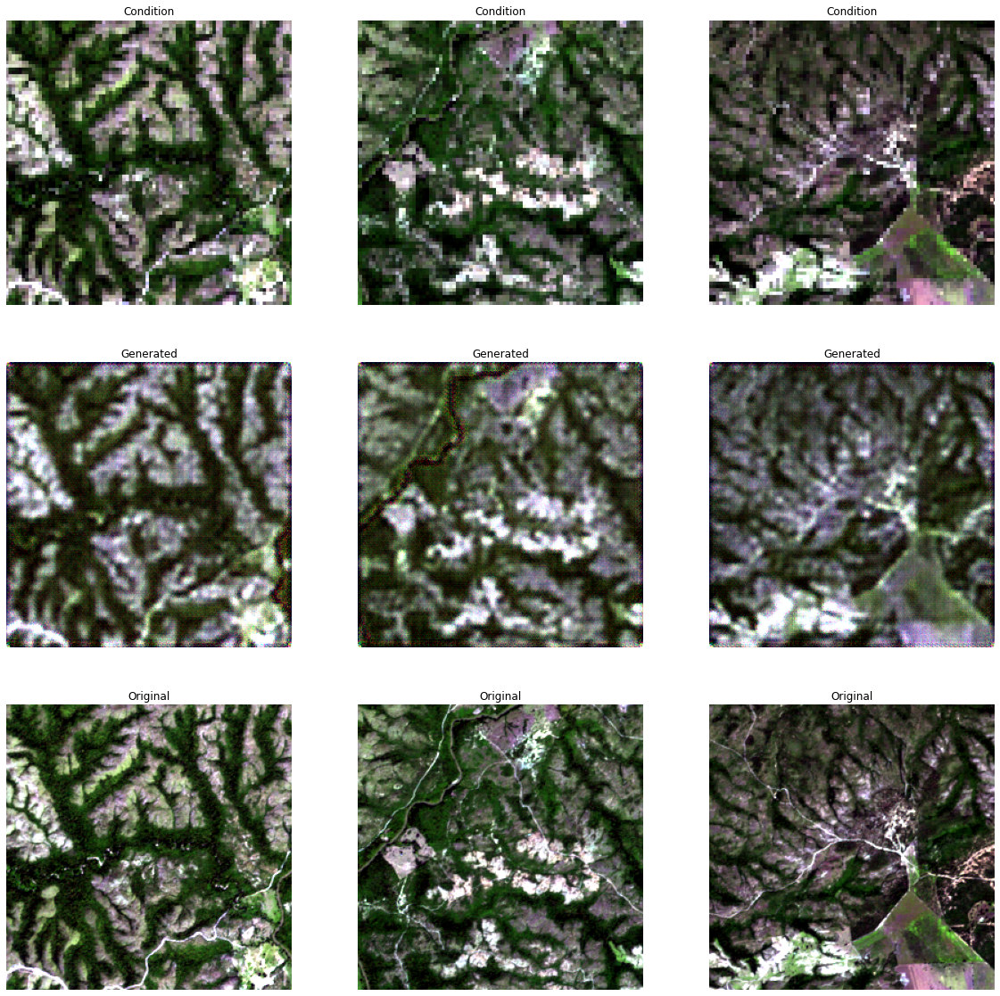

[Epoch 3] [Batch 0] [D1 loss: 0.367272] [D2 loss: 0.371578] [G loss: 2.663199]
[Epoch 3] [Batch 1] [D1 loss: 0.361916] [D2 loss: 0.379206] [G loss: 2.842102]
[Epoch 3] [Batch 2] [D1 loss: 0.368642] [D2 loss: 0.359754] [G loss: 2.650008]
[Epoch 3] [Batch 3] [D1 loss: 0.364652] [D2 loss: 0.380875] [G loss: 2.936902]
[Epoch 3] [Batch 4] [D1 loss: 0.359291] [D2 loss: 0.329159] [G loss: 2.689597]
[Epoch 3] [Batch 5] [D1 loss: 0.360452] [D2 loss: 0.360578] [G loss: 2.825982]
[Epoch 3] [Batch 6] [D1 loss: 0.352900] [D2 loss: 0.354684] [G loss: 2.666241]
[Epoch 3] [Batch 7] [D1 loss: 0.353139] [D2 loss: 0.389334] [G loss: 2.850721]
[Epoch 3] [Batch 8] [D1 loss: 0.357794] [D2 loss: 0.332091] [G loss: 2.636621]
[Epoch 3] [Batch 9] [D1 loss: 0.364553] [D2 loss: 0.363609] [G loss: 2.615441]
[Epoch 3] [Batch 10] [D1 loss: 0.353795] [D2 loss: 0.345347] [G loss: 2.601846]
[Epoch 3] [Batch 11] [D1 loss: 0.350094] [D2 loss: 0.384874] [G loss: 2.622844]
[Epoch 3] [Batch 12] [D1 loss: 0.355495] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


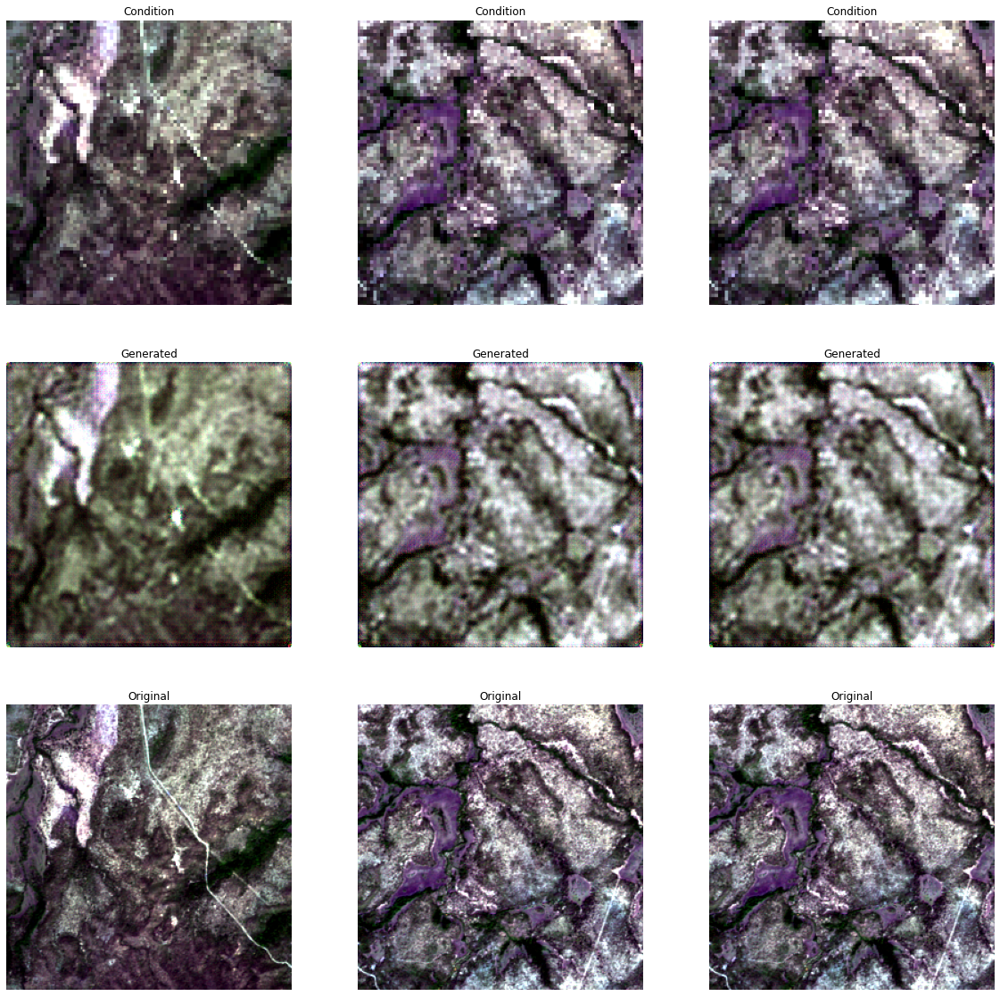

[Epoch 4] [Batch 0] [D1 loss: 0.379372] [D2 loss: 0.361843] [G loss: 2.523699]
[Epoch 4] [Batch 1] [D1 loss: 0.346755] [D2 loss: 0.387192] [G loss: 2.633621]
[Epoch 4] [Batch 2] [D1 loss: 0.367869] [D2 loss: 0.359567] [G loss: 2.862917]
[Epoch 4] [Batch 3] [D1 loss: 0.367673] [D2 loss: 0.360906] [G loss: 2.622729]
[Epoch 4] [Batch 4] [D1 loss: 0.366040] [D2 loss: 0.378004] [G loss: 2.925642]
[Epoch 4] [Batch 5] [D1 loss: 0.360679] [D2 loss: 0.375238] [G loss: 2.566474]
[Epoch 4] [Batch 6] [D1 loss: 0.368213] [D2 loss: 0.355699] [G loss: 2.453916]
[Epoch 4] [Batch 7] [D1 loss: 0.359248] [D2 loss: 0.381169] [G loss: 2.741458]
[Epoch 4] [Batch 8] [D1 loss: 0.370402] [D2 loss: 0.369326] [G loss: 2.853373]
[Epoch 4] [Batch 9] [D1 loss: 0.366232] [D2 loss: 0.347616] [G loss: 2.511167]
[Epoch 4] [Batch 10] [D1 loss: 0.355248] [D2 loss: 0.388369] [G loss: 2.499634]
[Epoch 4] [Batch 11] [D1 loss: 0.340311] [D2 loss: 0.365357] [G loss: 2.630790]
[Epoch 4] [Batch 12] [D1 loss: 0.368892] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


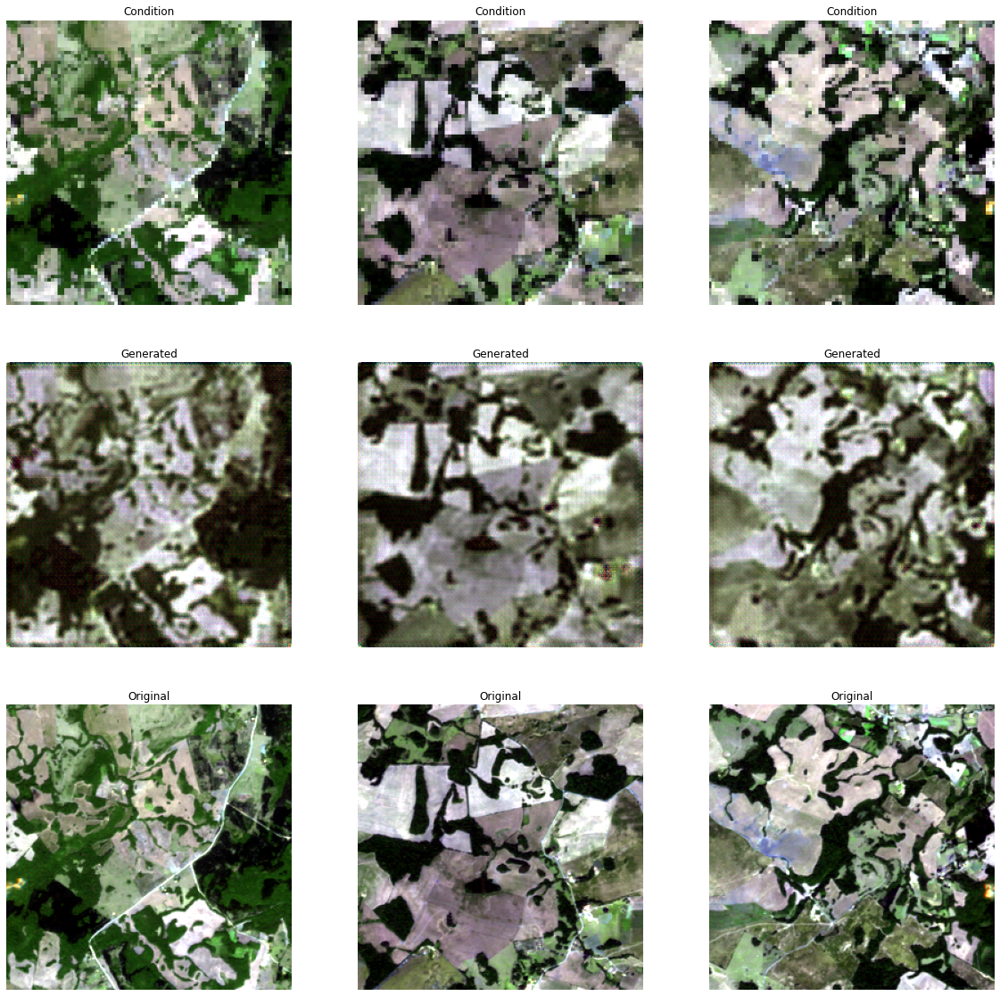

[Epoch 5] [Batch 0] [D1 loss: 0.086139] [D2 loss: 0.610475] [G loss: 3.066329]
[Epoch 5] [Batch 1] [D1 loss: 0.474389] [D2 loss: 0.105454] [G loss: 3.946195]
[Epoch 5] [Batch 2] [D1 loss: 0.263645] [D2 loss: 0.539265] [G loss: 3.830698]
[Epoch 5] [Batch 3] [D1 loss: 0.671307] [D2 loss: 0.082415] [G loss: 3.028257]
[Epoch 5] [Batch 4] [D1 loss: 0.144240] [D2 loss: 0.233615] [G loss: 4.527059]
[Epoch 5] [Batch 5] [D1 loss: 0.082835] [D2 loss: 0.158343] [G loss: 4.140795]
[Epoch 5] [Batch 6] [D1 loss: 0.110458] [D2 loss: 0.096253] [G loss: 2.971939]
[Epoch 5] [Batch 7] [D1 loss: 0.067357] [D2 loss: 0.364936] [G loss: 3.977839]
[Epoch 5] [Batch 8] [D1 loss: 0.613139] [D2 loss: 0.087936] [G loss: 3.421600]
[Epoch 5] [Batch 9] [D1 loss: 0.165842] [D2 loss: 1.029507] [G loss: 3.558109]
[Epoch 5] [Batch 10] [D1 loss: 0.402089] [D2 loss: 0.338728] [G loss: 3.362932]
[Epoch 5] [Batch 11] [D1 loss: 0.502639] [D2 loss: 0.603696] [G loss: 4.442180]
[Epoch 5] [Batch 12] [D1 loss: 0.374560] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


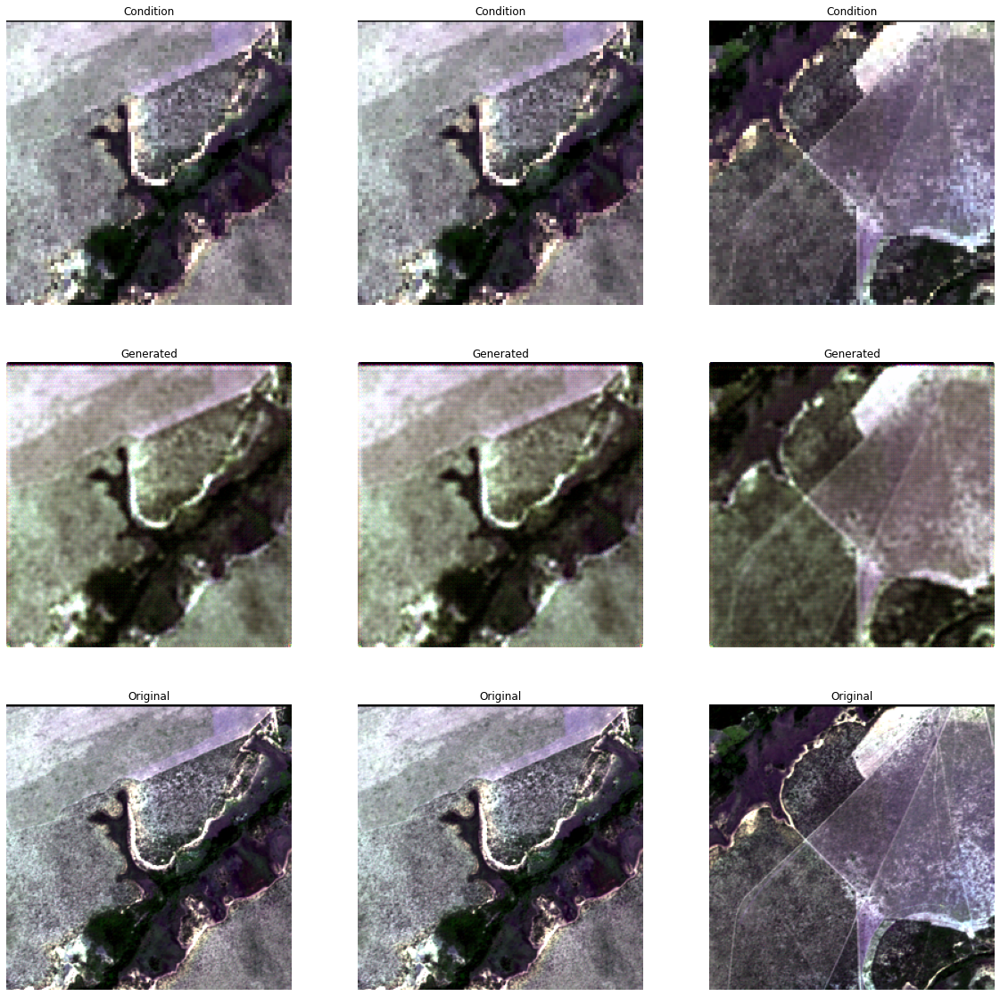

[Epoch 6] [Batch 0] [D1 loss: 0.350142] [D2 loss: 0.360845] [G loss: 2.760582]
[Epoch 6] [Batch 1] [D1 loss: 0.375033] [D2 loss: 0.353959] [G loss: 2.852363]
[Epoch 6] [Batch 2] [D1 loss: 0.369104] [D2 loss: 0.373653] [G loss: 2.342932]
[Epoch 6] [Batch 3] [D1 loss: 0.360047] [D2 loss: 0.369048] [G loss: 2.351484]
[Epoch 6] [Batch 4] [D1 loss: 0.372038] [D2 loss: 0.348775] [G loss: 2.482227]
[Epoch 6] [Batch 5] [D1 loss: 0.349517] [D2 loss: 0.351170] [G loss: 2.466857]
[Epoch 6] [Batch 6] [D1 loss: 0.356095] [D2 loss: 0.378356] [G loss: 2.388011]
[Epoch 6] [Batch 7] [D1 loss: 0.356066] [D2 loss: 0.358153] [G loss: 2.229459]
[Epoch 6] [Batch 8] [D1 loss: 0.344923] [D2 loss: 0.364996] [G loss: 2.392913]
[Epoch 6] [Batch 9] [D1 loss: 0.349803] [D2 loss: 0.369957] [G loss: 2.276923]
[Epoch 6] [Batch 10] [D1 loss: 0.356607] [D2 loss: 0.363333] [G loss: 2.380630]
[Epoch 6] [Batch 11] [D1 loss: 0.350480] [D2 loss: 0.367527] [G loss: 2.449115]
[Epoch 6] [Batch 12] [D1 loss: 0.349747] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


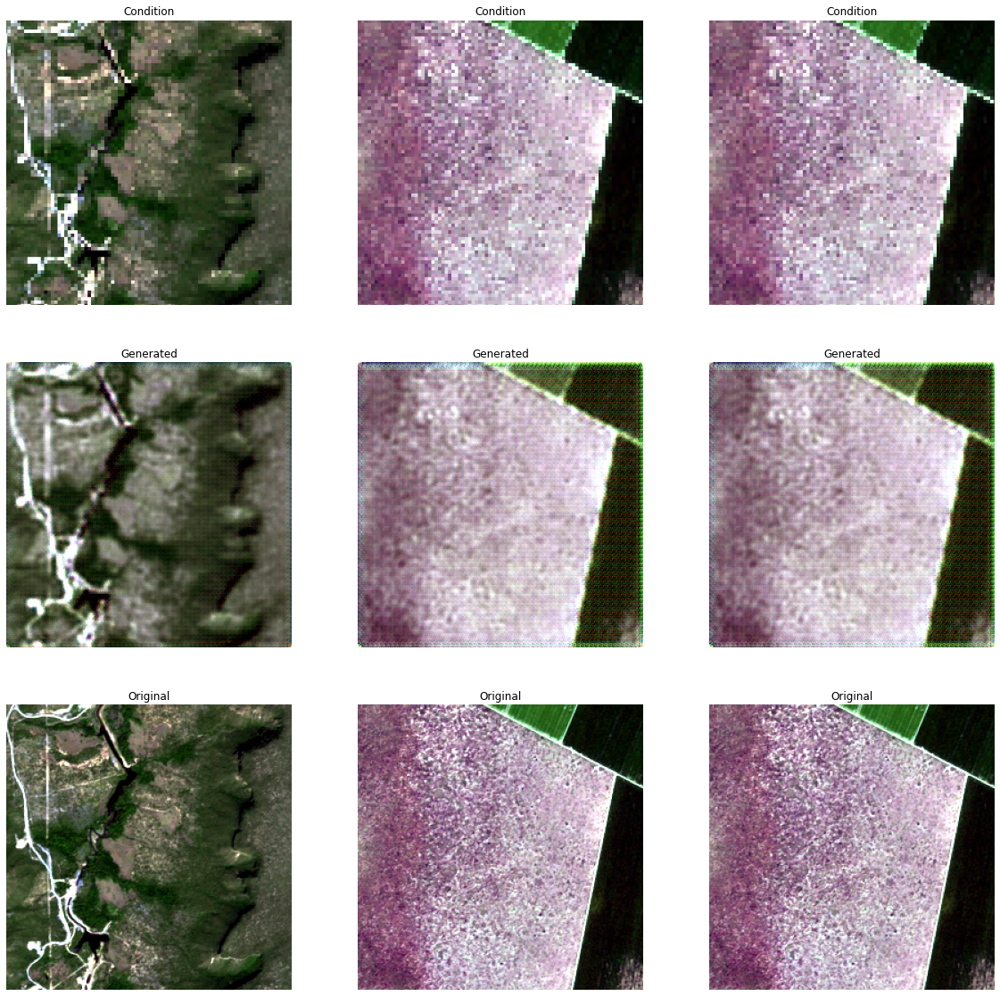

[Epoch 7] [Batch 0] [D1 loss: 1.207680] [D2 loss: 0.174600] [G loss: 3.406023]
[Epoch 7] [Batch 1] [D1 loss: 0.748436] [D2 loss: 0.107329] [G loss: 2.836873]
[Epoch 7] [Batch 2] [D1 loss: 0.244418] [D2 loss: 0.173044] [G loss: 1.978558]
[Epoch 7] [Batch 3] [D1 loss: 0.039186] [D2 loss: 0.485754] [G loss: 2.067680]
[Epoch 7] [Batch 4] [D1 loss: 0.064079] [D2 loss: 0.622167] [G loss: 3.524855]
[Epoch 7] [Batch 5] [D1 loss: 0.506158] [D2 loss: 0.057093] [G loss: 2.940565]
[Epoch 7] [Batch 6] [D1 loss: 0.141926] [D2 loss: 0.085579] [G loss: 2.332987]
[Epoch 7] [Batch 7] [D1 loss: 0.160590] [D2 loss: 0.089391] [G loss: 2.796567]
[Epoch 7] [Batch 8] [D1 loss: 0.170068] [D2 loss: 0.425792] [G loss: 3.150571]
[Epoch 7] [Batch 9] [D1 loss: 0.079482] [D2 loss: 0.101046] [G loss: 4.167615]
[Epoch 7] [Batch 10] [D1 loss: 0.071552] [D2 loss: 0.058545] [G loss: 3.968840]
[Epoch 7] [Batch 11] [D1 loss: 0.060919] [D2 loss: 0.087514] [G loss: 3.168827]
[Epoch 7] [Batch 12] [D1 loss: 0.055192] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


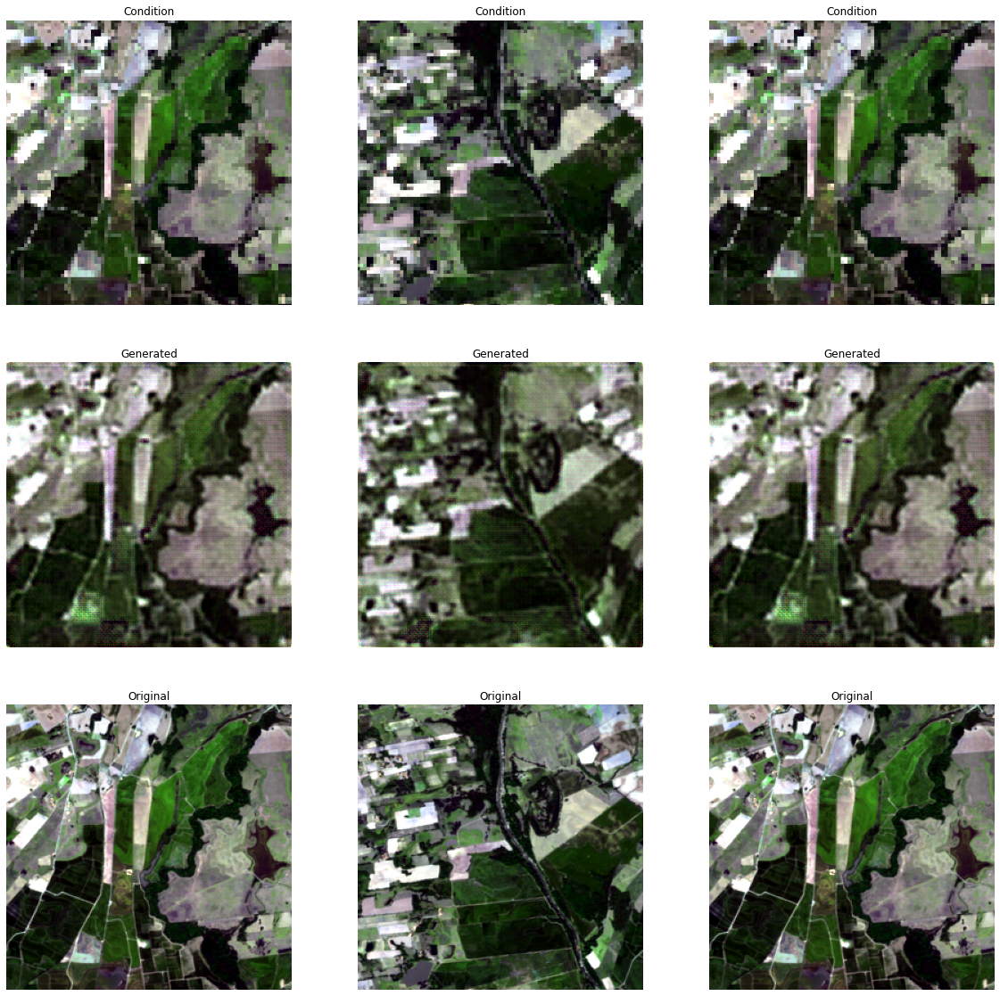

[Epoch 8] [Batch 0] [D1 loss: 0.408146] [D2 loss: 0.284335] [G loss: 2.253599]
[Epoch 8] [Batch 1] [D1 loss: 0.339186] [D2 loss: 0.172738] [G loss: 2.003030]
[Epoch 8] [Batch 2] [D1 loss: 0.149635] [D2 loss: 0.261220] [G loss: 2.393491]
[Epoch 8] [Batch 3] [D1 loss: 0.124073] [D2 loss: 0.338579] [G loss: 2.663643]
[Epoch 8] [Batch 4] [D1 loss: 0.182408] [D2 loss: 0.218238] [G loss: 2.484834]
[Epoch 8] [Batch 5] [D1 loss: 0.288738] [D2 loss: 0.554528] [G loss: 2.443137]
[Epoch 8] [Batch 6] [D1 loss: 0.295848] [D2 loss: 0.450683] [G loss: 2.711745]
[Epoch 8] [Batch 7] [D1 loss: 0.390368] [D2 loss: 0.104786] [G loss: 2.159245]
[Epoch 8] [Batch 8] [D1 loss: 0.132910] [D2 loss: 0.657660] [G loss: 2.976446]
[Epoch 8] [Batch 9] [D1 loss: 0.600263] [D2 loss: 0.184664] [G loss: 2.834931]
[Epoch 8] [Batch 10] [D1 loss: 0.556621] [D2 loss: 0.256558] [G loss: 2.724149]
[Epoch 8] [Batch 11] [D1 loss: 0.495966] [D2 loss: 0.276522] [G loss: 2.487315]
[Epoch 8] [Batch 12] [D1 loss: 0.338723] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


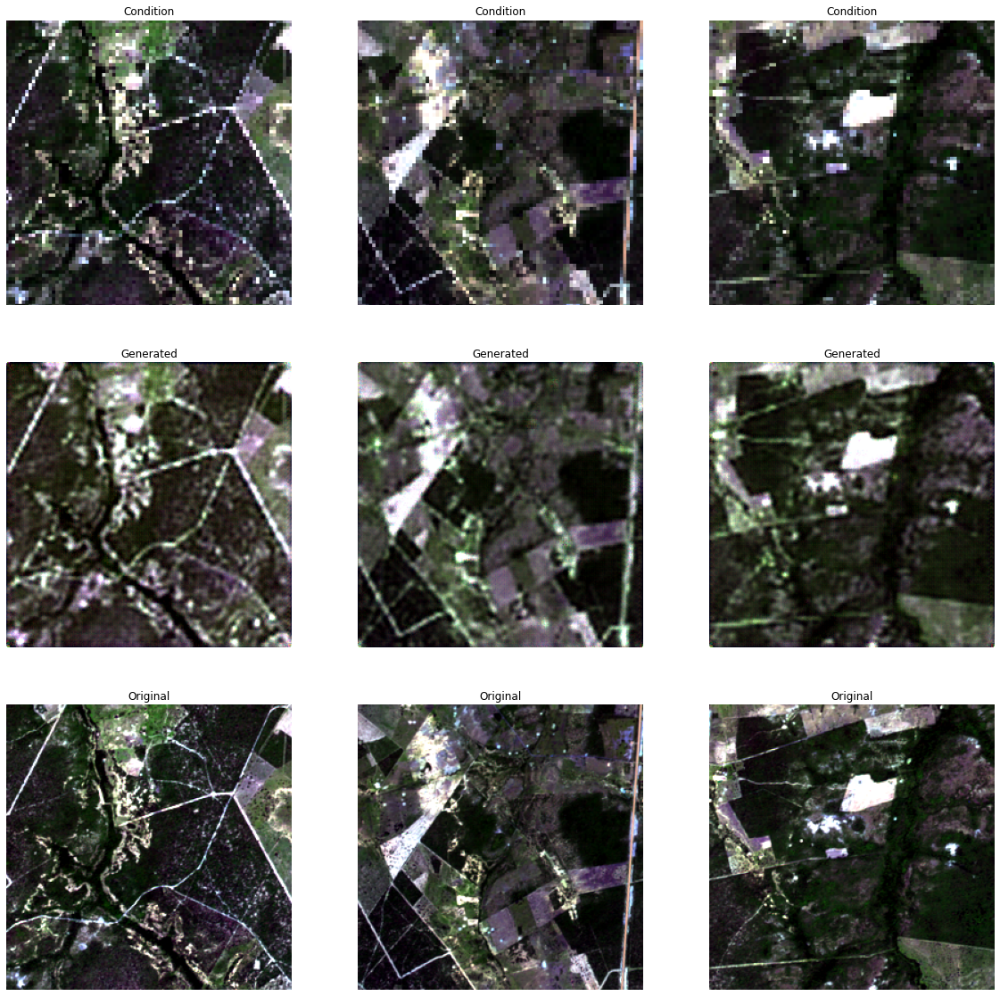

[Epoch 9] [Batch 0] [D1 loss: 0.372141] [D2 loss: 0.376085] [G loss: 2.307833]
[Epoch 9] [Batch 1] [D1 loss: 0.367682] [D2 loss: 0.380922] [G loss: 2.303945]
[Epoch 9] [Batch 2] [D1 loss: 0.358382] [D2 loss: 0.390021] [G loss: 2.427852]
[Epoch 9] [Batch 3] [D1 loss: 0.372992] [D2 loss: 0.379605] [G loss: 2.273462]
[Epoch 9] [Batch 4] [D1 loss: 0.383115] [D2 loss: 0.357498] [G loss: 2.225270]
[Epoch 9] [Batch 5] [D1 loss: 0.384137] [D2 loss: 0.362108] [G loss: 2.405343]
[Epoch 9] [Batch 6] [D1 loss: 0.365017] [D2 loss: 0.376047] [G loss: 2.340562]
[Epoch 9] [Batch 7] [D1 loss: 0.360987] [D2 loss: 0.387726] [G loss: 2.236709]
[Epoch 9] [Batch 8] [D1 loss: 0.380026] [D2 loss: 0.369849] [G loss: 2.219896]
[Epoch 9] [Batch 9] [D1 loss: 0.380640] [D2 loss: 0.366525] [G loss: 2.216730]
[Epoch 9] [Batch 10] [D1 loss: 0.355031] [D2 loss: 0.388182] [G loss: 2.411248]
[Epoch 9] [Batch 11] [D1 loss: 0.382103] [D2 loss: 0.369464] [G loss: 2.810111]
[Epoch 9] [Batch 12] [D1 loss: 0.367191] [D2 loss:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


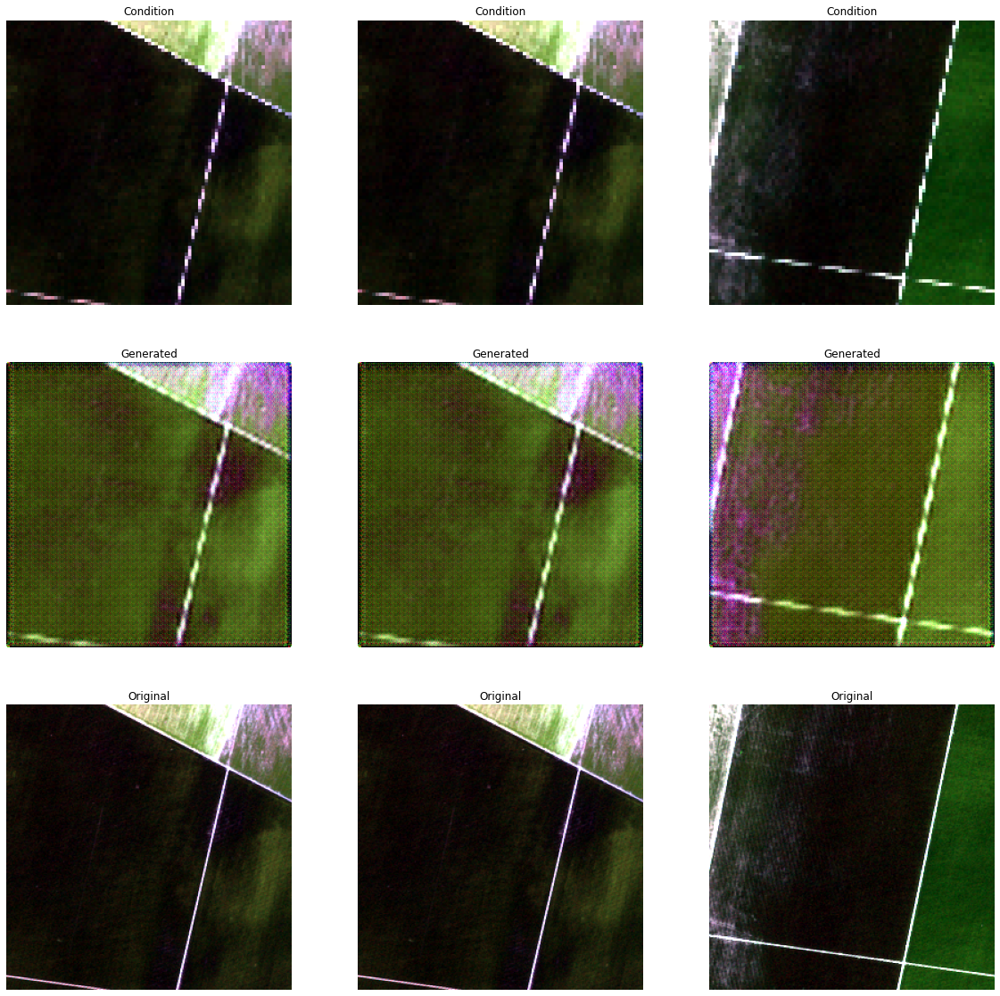

[Epoch 10] [Batch 0] [D1 loss: 0.172233] [D2 loss: 0.570505] [G loss: 2.373466]
[Epoch 10] [Batch 1] [D1 loss: 0.396692] [D2 loss: 0.452643] [G loss: 2.433145]
[Epoch 10] [Batch 2] [D1 loss: 0.267027] [D2 loss: 0.458691] [G loss: 2.417488]
[Epoch 10] [Batch 3] [D1 loss: 0.258204] [D2 loss: 0.243868] [G loss: 3.112058]
[Epoch 10] [Batch 4] [D1 loss: 0.325628] [D2 loss: 0.395350] [G loss: 2.578253]
[Epoch 10] [Batch 5] [D1 loss: 0.288844] [D2 loss: 0.343672] [G loss: 2.573582]
[Epoch 10] [Batch 6] [D1 loss: 0.174951] [D2 loss: 0.596124] [G loss: 2.826808]
[Epoch 10] [Batch 7] [D1 loss: 0.564377] [D2 loss: 0.117979] [G loss: 2.774891]
[Epoch 10] [Batch 8] [D1 loss: 0.350248] [D2 loss: 0.546653] [G loss: 2.918928]
[Epoch 10] [Batch 9] [D1 loss: 0.505673] [D2 loss: 0.281857] [G loss: 3.233322]
[Epoch 10] [Batch 10] [D1 loss: 0.459914] [D2 loss: 0.268796] [G loss: 2.879293]
[Epoch 10] [Batch 11] [D1 loss: 0.419677] [D2 loss: 0.347139] [G loss: 2.603871]
[Epoch 10] [Batch 12] [D1 loss: 0.4104

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


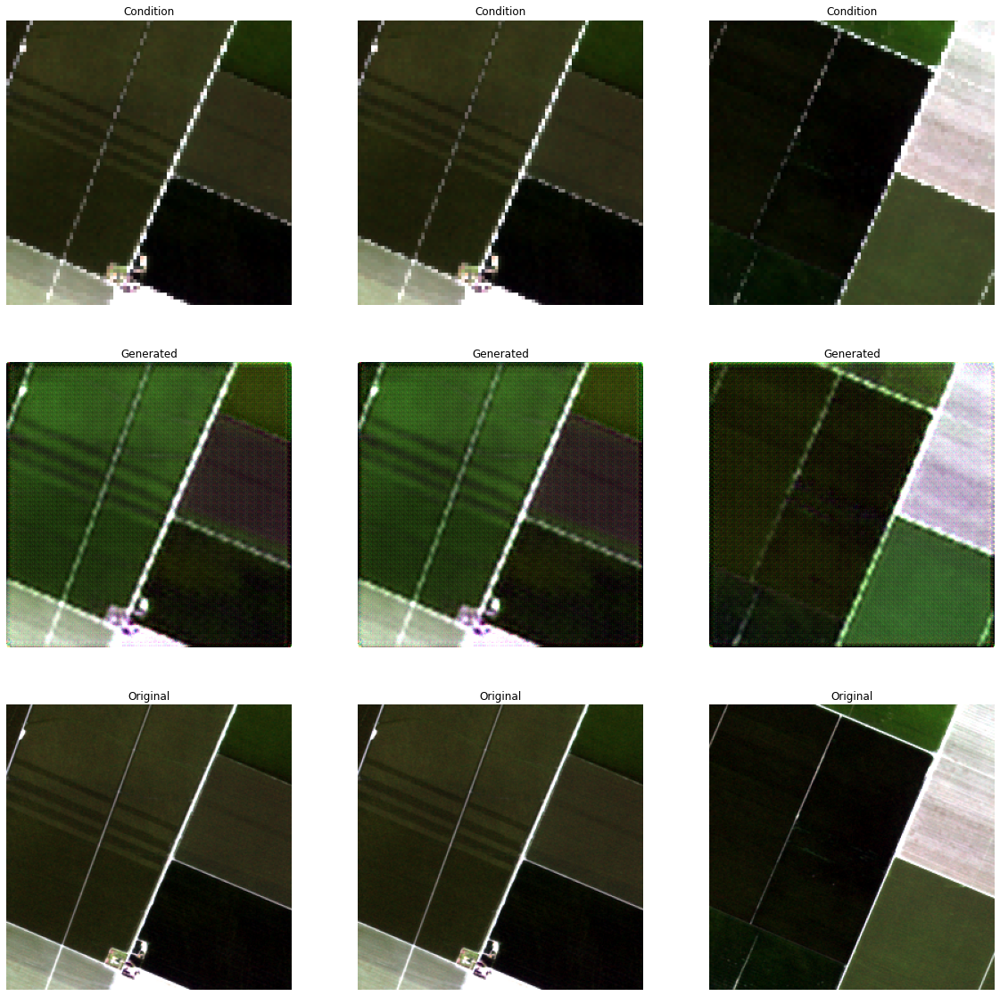

[Epoch 11] [Batch 0] [D1 loss: 0.312310] [D2 loss: 0.403652] [G loss: 2.160584]
[Epoch 11] [Batch 1] [D1 loss: 0.347230] [D2 loss: 0.381768] [G loss: 2.221856]
[Epoch 11] [Batch 2] [D1 loss: 0.334708] [D2 loss: 0.407004] [G loss: 2.211866]
[Epoch 11] [Batch 3] [D1 loss: 0.337364] [D2 loss: 0.410116] [G loss: 2.163307]
[Epoch 11] [Batch 4] [D1 loss: 0.358880] [D2 loss: 0.357018] [G loss: 2.284705]
[Epoch 11] [Batch 5] [D1 loss: 0.368675] [D2 loss: 0.370553] [G loss: 2.808318]
[Epoch 11] [Batch 6] [D1 loss: 0.359384] [D2 loss: 0.363384] [G loss: 2.237006]
[Epoch 11] [Batch 7] [D1 loss: 0.363924] [D2 loss: 0.350527] [G loss: 2.626838]
[Epoch 11] [Batch 8] [D1 loss: 0.359085] [D2 loss: 0.399916] [G loss: 2.279322]
[Epoch 11] [Batch 9] [D1 loss: 0.366330] [D2 loss: 0.329921] [G loss: 2.203899]
[Epoch 11] [Batch 10] [D1 loss: 0.361971] [D2 loss: 0.315305] [G loss: 2.135694]
[Epoch 11] [Batch 11] [D1 loss: 0.310955] [D2 loss: 0.375391] [G loss: 2.360076]
[Epoch 11] [Batch 12] [D1 loss: 0.3541

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


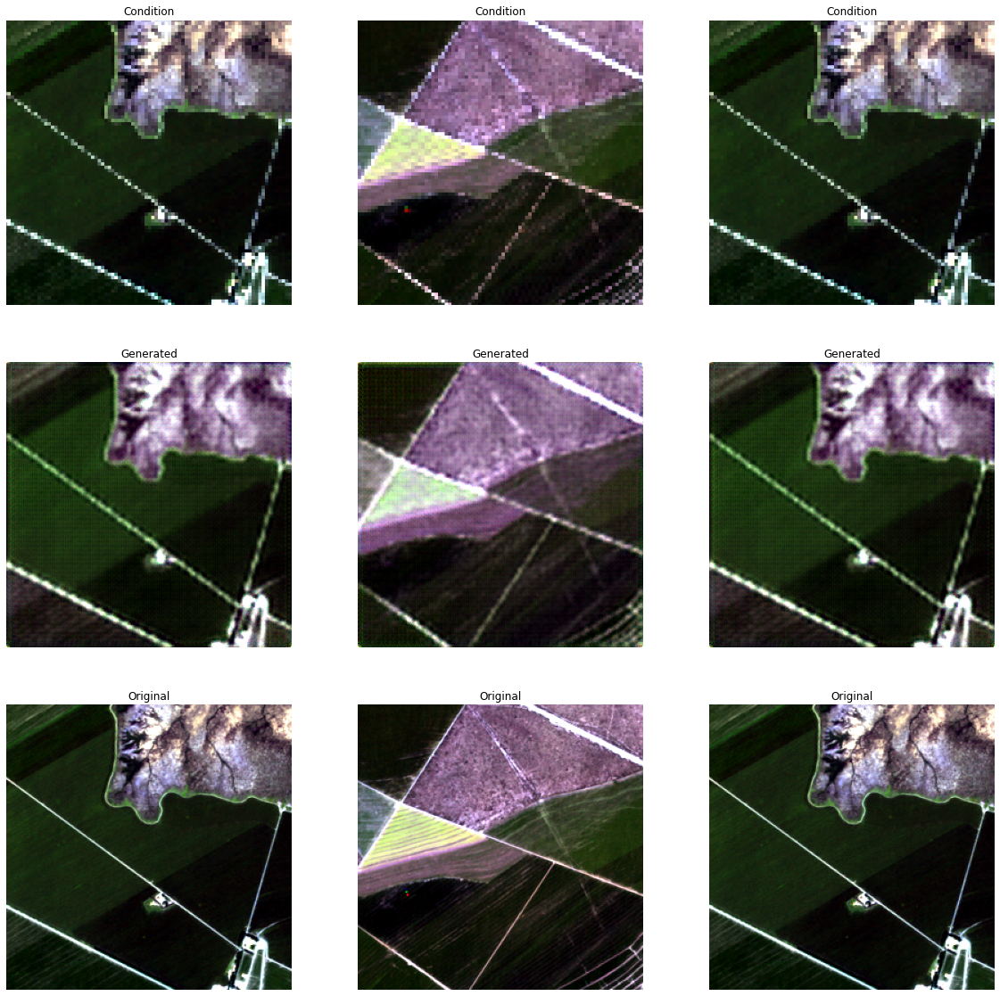

[Epoch 12] [Batch 0] [D1 loss: 0.351277] [D2 loss: 0.327683] [G loss: 2.440503]
[Epoch 12] [Batch 1] [D1 loss: 0.335485] [D2 loss: 0.366346] [G loss: 2.580881]
[Epoch 12] [Batch 2] [D1 loss: 0.305832] [D2 loss: 0.380948] [G loss: 2.253712]
[Epoch 12] [Batch 3] [D1 loss: 0.367667] [D2 loss: 0.262073] [G loss: 2.150988]
[Epoch 12] [Batch 4] [D1 loss: 0.342991] [D2 loss: 0.307926] [G loss: 2.105381]
[Epoch 12] [Batch 5] [D1 loss: 0.341891] [D2 loss: 0.394989] [G loss: 2.304661]
[Epoch 12] [Batch 6] [D1 loss: 0.347837] [D2 loss: 0.234789] [G loss: 2.088995]
[Epoch 12] [Batch 7] [D1 loss: 0.338479] [D2 loss: 0.382053] [G loss: 2.102249]
[Epoch 12] [Batch 8] [D1 loss: 0.300246] [D2 loss: 0.299095] [G loss: 2.103681]
[Epoch 12] [Batch 9] [D1 loss: 0.319655] [D2 loss: 0.246156] [G loss: 1.991465]
[Epoch 12] [Batch 10] [D1 loss: 0.317549] [D2 loss: 0.347855] [G loss: 1.971100]
[Epoch 12] [Batch 11] [D1 loss: 0.278466] [D2 loss: 0.251983] [G loss: 2.001905]
[Epoch 12] [Batch 12] [D1 loss: 0.2683

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


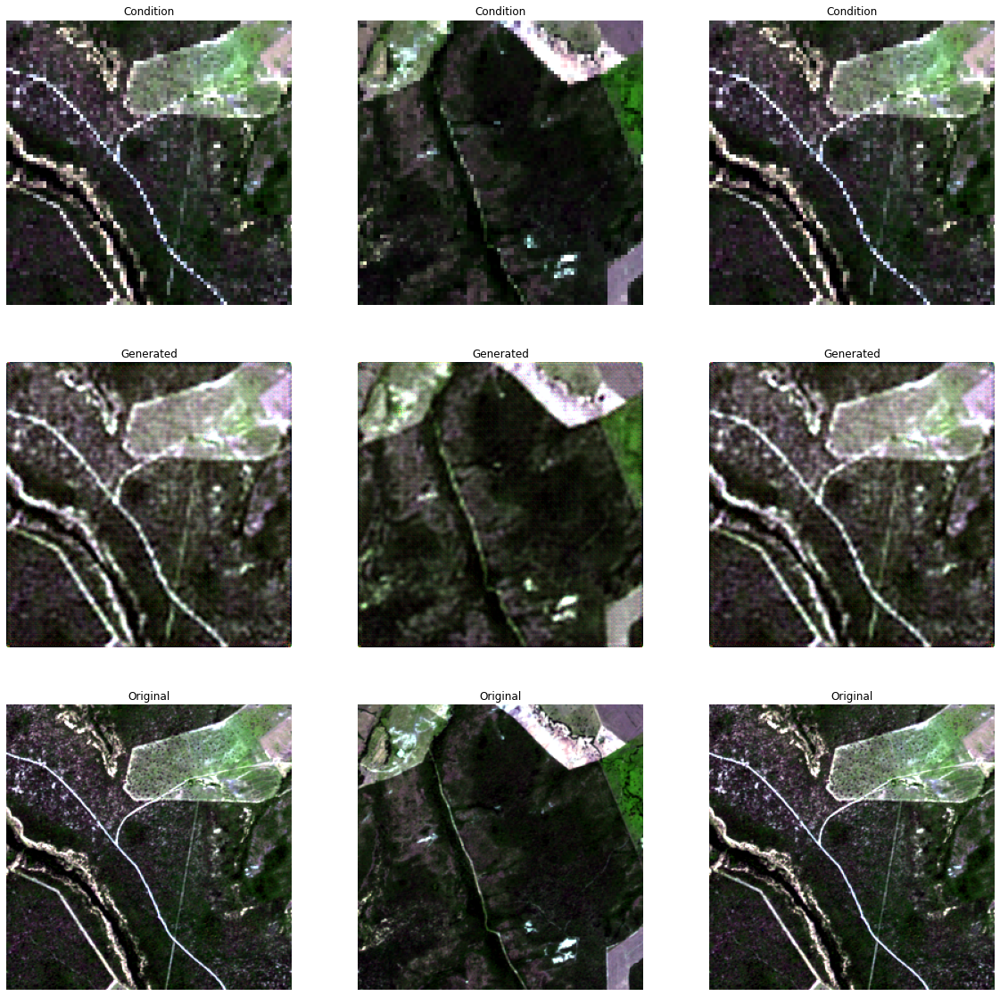

[Epoch 13] [Batch 0] [D1 loss: 0.086603] [D2 loss: 0.418858] [G loss: 2.676202]
[Epoch 13] [Batch 1] [D1 loss: 0.256199] [D2 loss: 0.065837] [G loss: 1.967694]
[Epoch 13] [Batch 2] [D1 loss: 0.097813] [D2 loss: 0.074545] [G loss: 2.007932]
[Epoch 13] [Batch 3] [D1 loss: 0.050098] [D2 loss: 0.423286] [G loss: 3.023620]
[Epoch 13] [Batch 4] [D1 loss: 0.293555] [D2 loss: 0.084541] [G loss: 2.267243]
[Epoch 13] [Batch 5] [D1 loss: 0.050977] [D2 loss: 0.404401] [G loss: 1.878801]
[Epoch 13] [Batch 6] [D1 loss: 0.124167] [D2 loss: 0.244152] [G loss: 3.150289]
[Epoch 13] [Batch 7] [D1 loss: 0.278760] [D2 loss: 0.238851] [G loss: 2.546600]
[Epoch 13] [Batch 8] [D1 loss: 0.355661] [D2 loss: 0.096144] [G loss: 2.016970]
[Epoch 13] [Batch 9] [D1 loss: 0.104315] [D2 loss: 1.090147] [G loss: 2.922563]
[Epoch 13] [Batch 10] [D1 loss: 0.423864] [D2 loss: 0.066900] [G loss: 1.798637]
[Epoch 13] [Batch 11] [D1 loss: 0.240958] [D2 loss: 0.564774] [G loss: 2.741838]
[Epoch 13] [Batch 12] [D1 loss: 0.2759

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


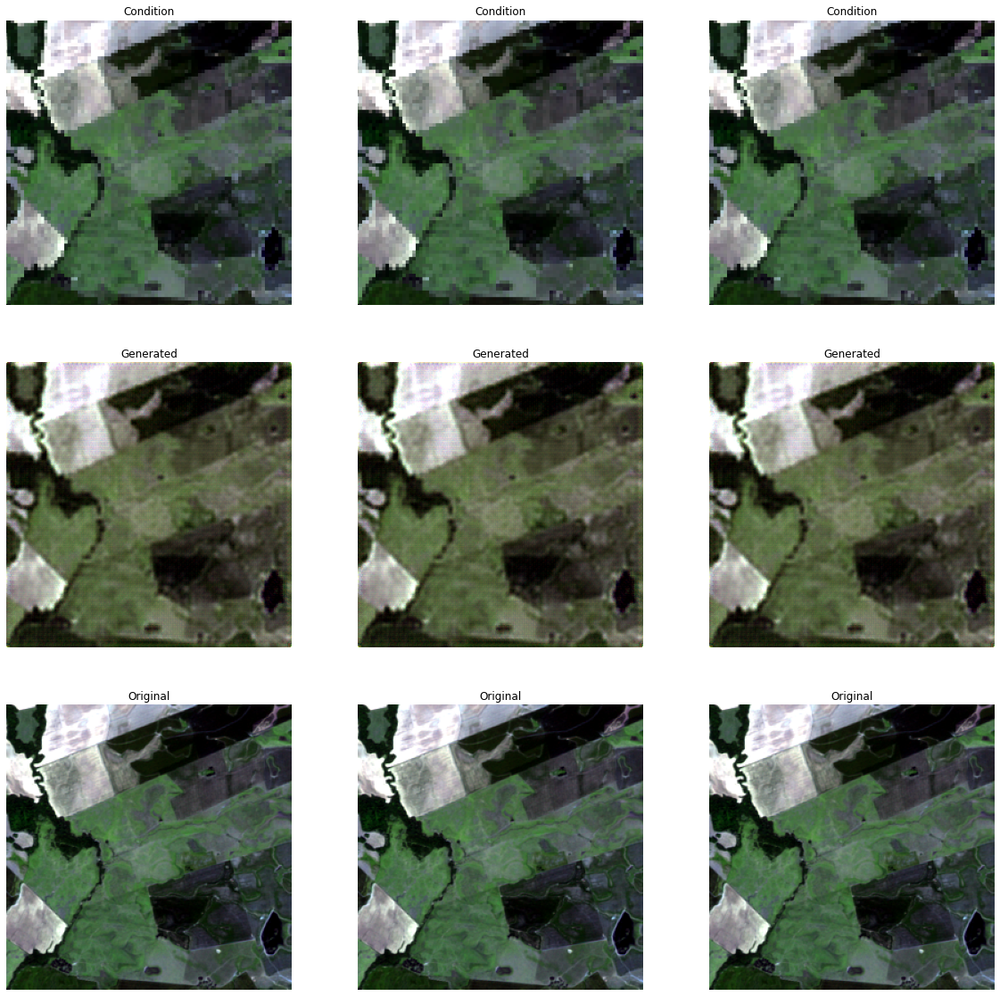

[Epoch 14] [Batch 0] [D1 loss: 0.304735] [D2 loss: 0.094756] [G loss: 3.123830]
[Epoch 14] [Batch 1] [D1 loss: 0.273624] [D2 loss: 0.039695] [G loss: 1.976272]
[Epoch 14] [Batch 2] [D1 loss: 0.061080] [D2 loss: 0.041449] [G loss: 1.568763]
[Epoch 14] [Batch 3] [D1 loss: 0.020951] [D2 loss: 0.132562] [G loss: 1.647329]
[Epoch 14] [Batch 4] [D1 loss: 0.022192] [D2 loss: 0.096322] [G loss: 1.629122]
[Epoch 14] [Batch 5] [D1 loss: 0.026936] [D2 loss: 0.905654] [G loss: 3.550025]
[Epoch 14] [Batch 6] [D1 loss: 0.546256] [D2 loss: 0.329028] [G loss: 2.283177]
[Epoch 14] [Batch 7] [D1 loss: 0.257559] [D2 loss: 0.028730] [G loss: 3.423489]
[Epoch 14] [Batch 8] [D1 loss: 0.126669] [D2 loss: 0.161171] [G loss: 2.617526]
[Epoch 14] [Batch 9] [D1 loss: 0.059431] [D2 loss: 0.660233] [G loss: 3.256222]
[Epoch 14] [Batch 10] [D1 loss: 0.410227] [D2 loss: 0.017763] [G loss: 1.740966]
[Epoch 14] [Batch 11] [D1 loss: 0.120151] [D2 loss: 0.601267] [G loss: 2.983627]
[Epoch 14] [Batch 12] [D1 loss: 0.4998

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


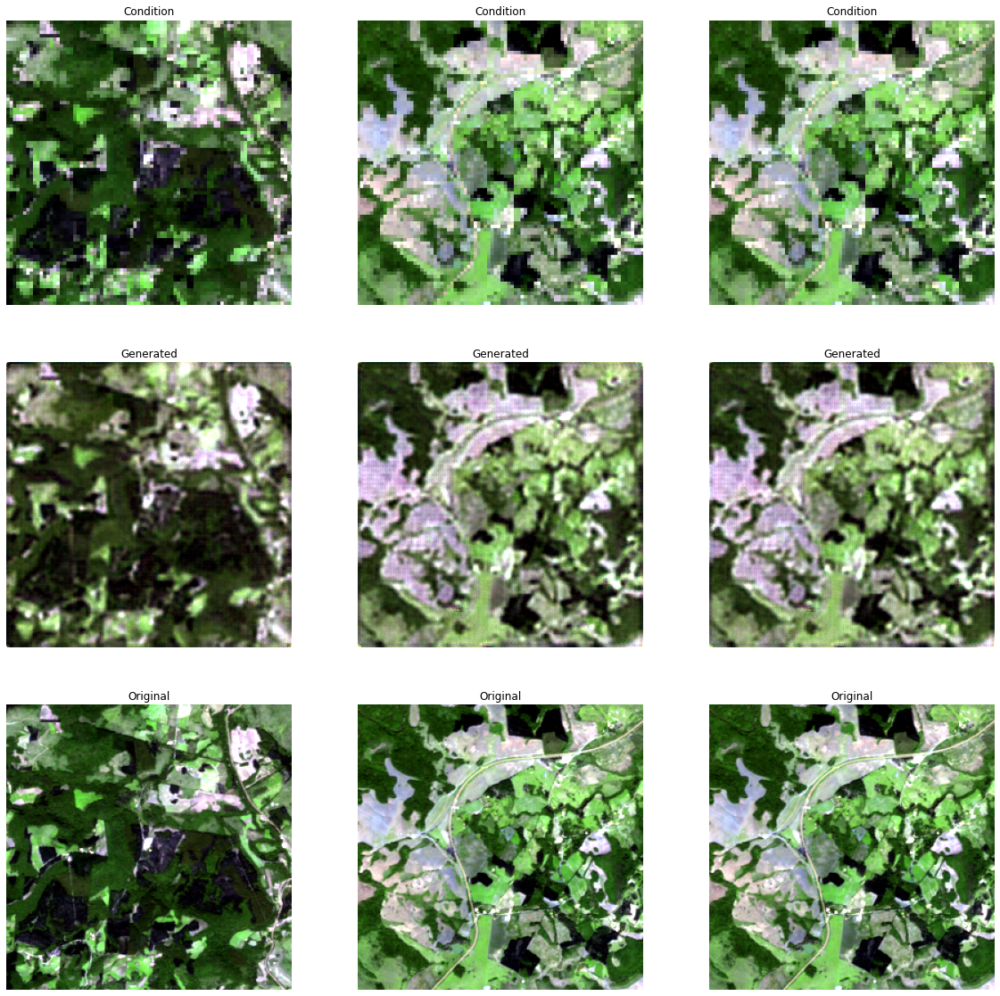

[Epoch 15] [Batch 0] [D1 loss: 0.039529] [D2 loss: 0.998401] [G loss: 2.685938]
[Epoch 15] [Batch 1] [D1 loss: 0.497235] [D2 loss: 0.022833] [G loss: 2.745317]
[Epoch 15] [Batch 2] [D1 loss: 0.107363] [D2 loss: 0.031030] [G loss: 1.690474]
[Epoch 15] [Batch 3] [D1 loss: 0.063676] [D2 loss: 0.118136] [G loss: 2.199109]
[Epoch 15] [Batch 4] [D1 loss: 0.058312] [D2 loss: 1.038923] [G loss: 2.370641]
[Epoch 15] [Batch 5] [D1 loss: 0.377903] [D2 loss: 0.223014] [G loss: 2.113178]
[Epoch 15] [Batch 6] [D1 loss: 0.185554] [D2 loss: 0.027489] [G loss: 2.052136]
[Epoch 15] [Batch 7] [D1 loss: 0.125265] [D2 loss: 0.021491] [G loss: 1.986219]
[Epoch 15] [Batch 8] [D1 loss: 0.074685] [D2 loss: 0.090274] [G loss: 2.655782]
[Epoch 15] [Batch 9] [D1 loss: 0.051554] [D2 loss: 1.034569] [G loss: 2.081942]
[Epoch 15] [Batch 10] [D1 loss: 0.255154] [D2 loss: 0.099546] [G loss: 2.330683]
[Epoch 15] [Batch 11] [D1 loss: 0.159821] [D2 loss: 0.201838] [G loss: 1.943640]
[Epoch 15] [Batch 12] [D1 loss: 0.1282

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


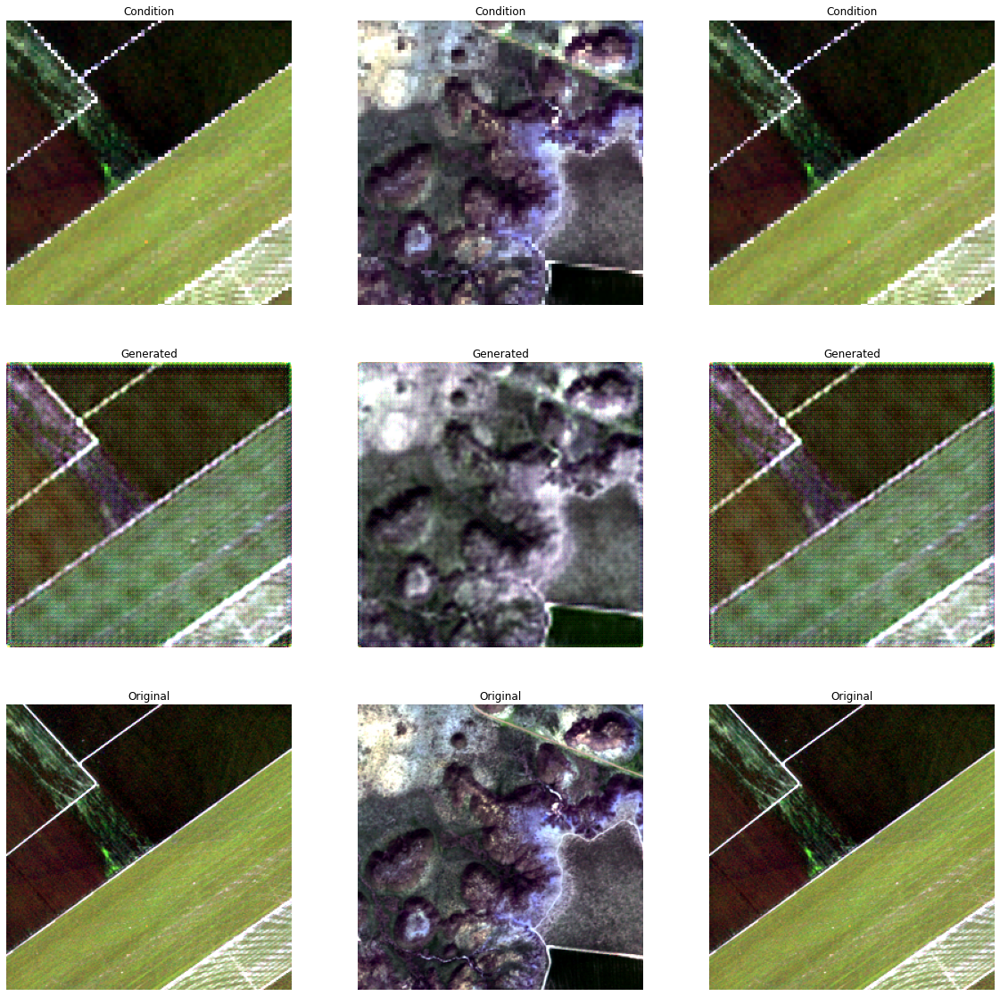

[Epoch 16] [Batch 0] [D1 loss: 0.293288] [D2 loss: 0.078511] [G loss: 3.704104]
[Epoch 16] [Batch 1] [D1 loss: 0.495134] [D2 loss: 0.517614] [G loss: 3.298478]
[Epoch 16] [Batch 2] [D1 loss: 0.156232] [D2 loss: 0.038677] [G loss: 3.709686]
[Epoch 16] [Batch 3] [D1 loss: 0.101445] [D2 loss: 0.019228] [G loss: 2.105607]
[Epoch 16] [Batch 4] [D1 loss: 0.034206] [D2 loss: 0.015774] [G loss: 2.647050]
[Epoch 16] [Batch 5] [D1 loss: 0.032511] [D2 loss: 0.139363] [G loss: 3.799080]
[Epoch 16] [Batch 6] [D1 loss: 0.039809] [D2 loss: 0.261959] [G loss: 3.024511]
[Epoch 16] [Batch 7] [D1 loss: 0.090152] [D2 loss: 0.072984] [G loss: 2.733654]
[Epoch 16] [Batch 8] [D1 loss: 0.051906] [D2 loss: 0.021891] [G loss: 2.424807]
[Epoch 16] [Batch 9] [D1 loss: 0.050943] [D2 loss: 0.179367] [G loss: 1.768175]
[Epoch 16] [Batch 10] [D1 loss: 0.065319] [D2 loss: 0.236297] [G loss: 3.870058]
[Epoch 16] [Batch 11] [D1 loss: 0.130227] [D2 loss: 0.081821] [G loss: 3.943321]
[Epoch 16] [Batch 12] [D1 loss: 0.0773

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


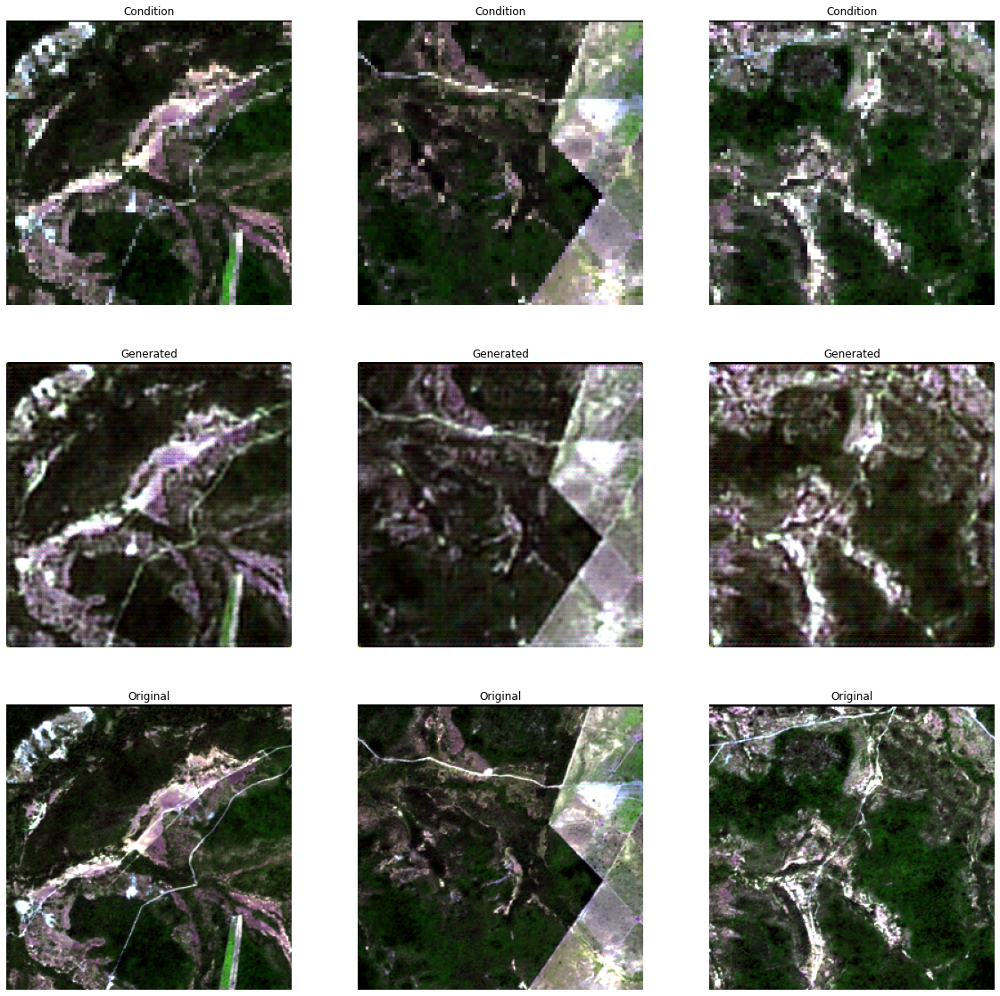

[Epoch 17] [Batch 0] [D1 loss: 0.071357] [D2 loss: 0.022548] [G loss: 1.671554]
[Epoch 17] [Batch 1] [D1 loss: 0.040015] [D2 loss: 0.014645] [G loss: 1.669782]
[Epoch 17] [Batch 2] [D1 loss: 0.031181] [D2 loss: 0.047297] [G loss: 1.617567]
[Epoch 17] [Batch 3] [D1 loss: 0.030367] [D2 loss: 0.007366] [G loss: 1.467682]
[Epoch 17] [Batch 4] [D1 loss: 0.027124] [D2 loss: 0.008072] [G loss: 1.502211]
[Epoch 17] [Batch 5] [D1 loss: 0.043963] [D2 loss: 0.024582] [G loss: 1.698248]
[Epoch 17] [Batch 6] [D1 loss: 0.033813] [D2 loss: 0.057094] [G loss: 1.588699]
[Epoch 17] [Batch 7] [D1 loss: 0.027354] [D2 loss: 0.091003] [G loss: 1.636374]
[Epoch 17] [Batch 8] [D1 loss: 0.030735] [D2 loss: 0.014944] [G loss: 1.715089]
[Epoch 17] [Batch 9] [D1 loss: 0.040919] [D2 loss: 0.013915] [G loss: 1.663068]
[Epoch 17] [Batch 10] [D1 loss: 0.029186] [D2 loss: 0.108130] [G loss: 1.557715]
[Epoch 17] [Batch 11] [D1 loss: 0.027533] [D2 loss: 0.048547] [G loss: 1.866453]
[Epoch 17] [Batch 12] [D1 loss: 0.0499

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


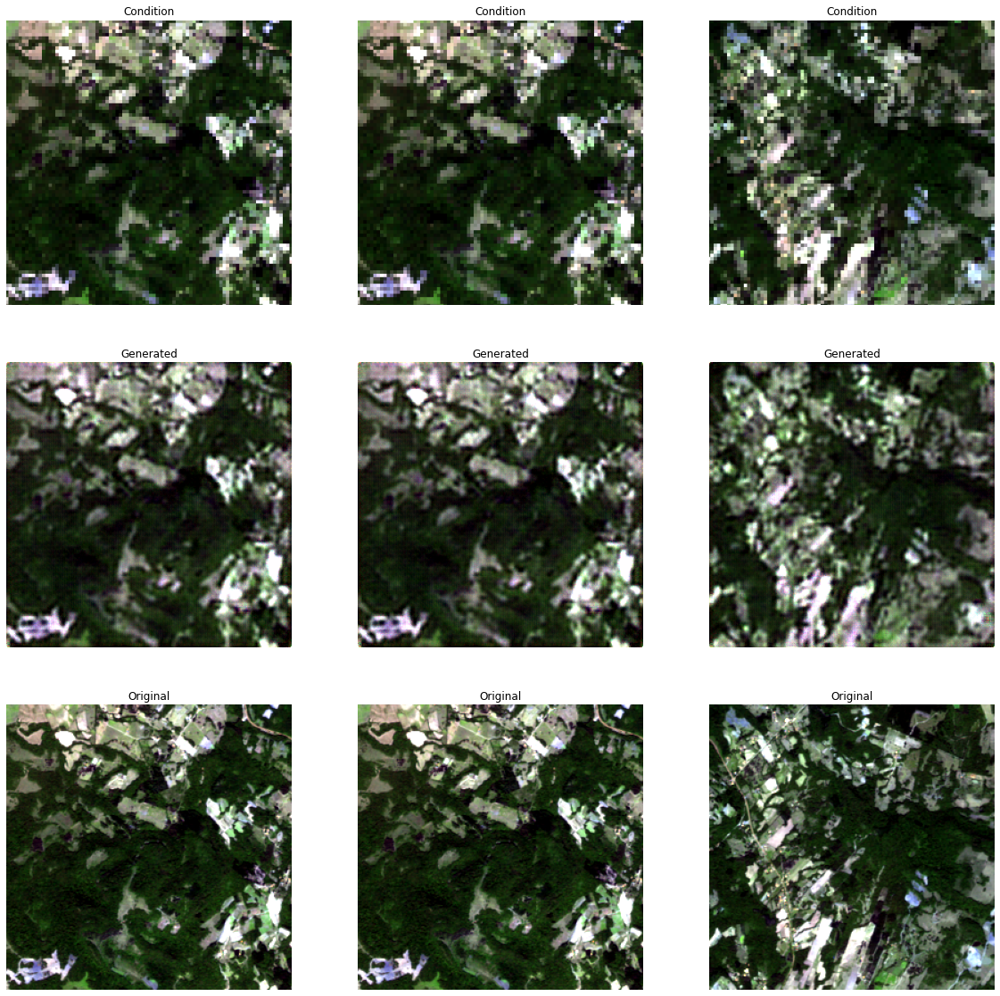

[Epoch 18] [Batch 0] [D1 loss: 0.085099] [D2 loss: 0.007133] [G loss: 1.676982]
[Epoch 18] [Batch 1] [D1 loss: 0.053149] [D2 loss: 0.039186] [G loss: 1.844345]
[Epoch 18] [Batch 2] [D1 loss: 0.037276] [D2 loss: 0.030918] [G loss: 1.756410]
[Epoch 18] [Batch 3] [D1 loss: 0.034995] [D2 loss: 0.053163] [G loss: 1.656527]
[Epoch 18] [Batch 4] [D1 loss: 0.045275] [D2 loss: 0.078174] [G loss: 1.651723]
[Epoch 18] [Batch 5] [D1 loss: 0.038357] [D2 loss: 0.033029] [G loss: 1.644536]
[Epoch 18] [Batch 6] [D1 loss: 0.047513] [D2 loss: 0.037084] [G loss: 1.659961]
[Epoch 18] [Batch 7] [D1 loss: 0.039033] [D2 loss: 0.226694] [G loss: 1.541301]
[Epoch 18] [Batch 8] [D1 loss: 0.083168] [D2 loss: 0.007403] [G loss: 2.260769]
[Epoch 18] [Batch 9] [D1 loss: 0.075813] [D2 loss: 0.030784] [G loss: 3.148327]
[Epoch 18] [Batch 10] [D1 loss: 0.049369] [D2 loss: 0.063150] [G loss: 1.619592]
[Epoch 18] [Batch 11] [D1 loss: 0.051654] [D2 loss: 0.025800] [G loss: 1.592305]
[Epoch 18] [Batch 12] [D1 loss: 0.0378

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


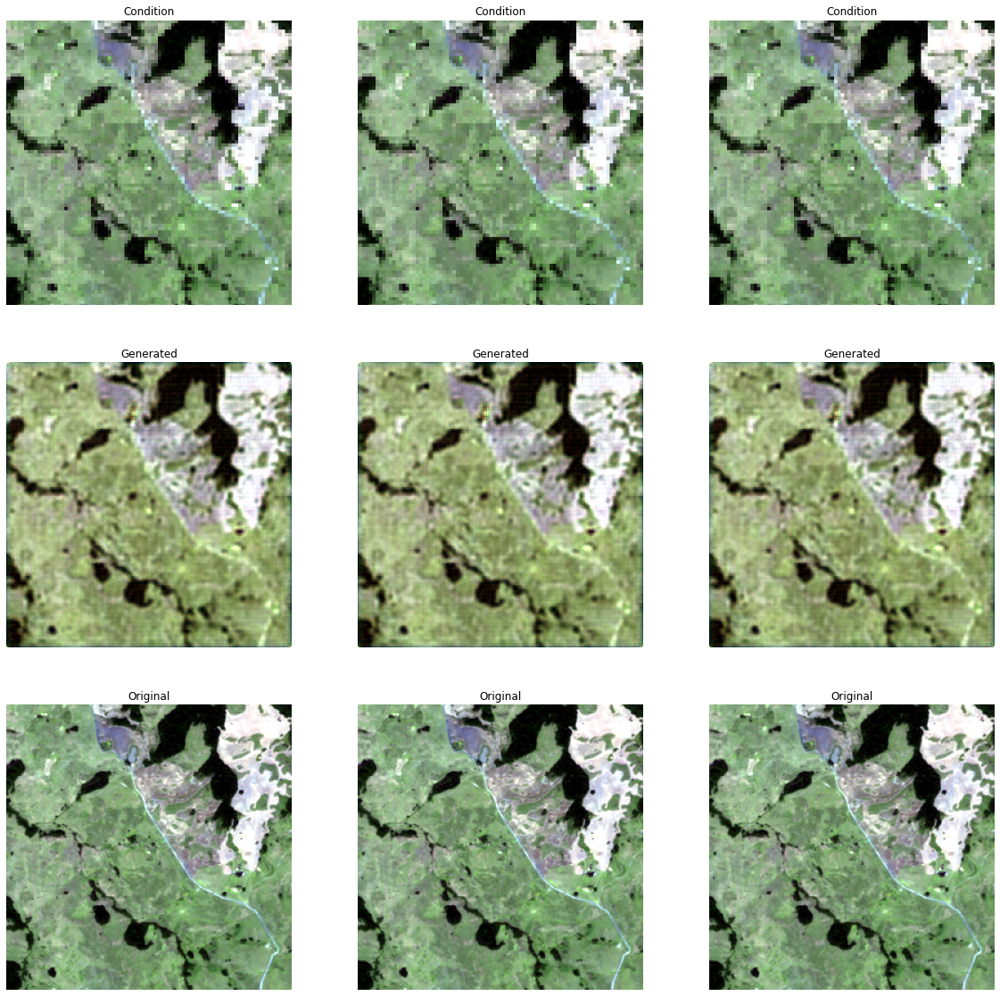

[Epoch 19] [Batch 0] [D1 loss: 0.042865] [D2 loss: 0.009858] [G loss: 1.925709]
[Epoch 19] [Batch 1] [D1 loss: 0.050268] [D2 loss: 0.453638] [G loss: 3.769330]
[Epoch 19] [Batch 2] [D1 loss: 0.409112] [D2 loss: 0.063393] [G loss: 2.131211]
[Epoch 19] [Batch 3] [D1 loss: 0.077256] [D2 loss: 0.015305] [G loss: 1.885853]
[Epoch 19] [Batch 4] [D1 loss: 0.041285] [D2 loss: 0.052895] [G loss: 1.764037]
[Epoch 19] [Batch 5] [D1 loss: 0.037429] [D2 loss: 0.251730] [G loss: 1.885167]
[Epoch 19] [Batch 6] [D1 loss: 0.061502] [D2 loss: 0.005563] [G loss: 1.818672]
[Epoch 19] [Batch 7] [D1 loss: 0.051093] [D2 loss: 0.058789] [G loss: 2.060693]
[Epoch 19] [Batch 8] [D1 loss: 0.048447] [D2 loss: 0.012441] [G loss: 1.580119]
[Epoch 19] [Batch 9] [D1 loss: 0.056702] [D2 loss: 0.608656] [G loss: 3.060106]
[Epoch 19] [Batch 10] [D1 loss: 0.317029] [D2 loss: 0.068208] [G loss: 4.535962]
[Epoch 19] [Batch 11] [D1 loss: 0.226548] [D2 loss: 0.084858] [G loss: 3.446417]
[Epoch 19] [Batch 12] [D1 loss: 0.0339

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


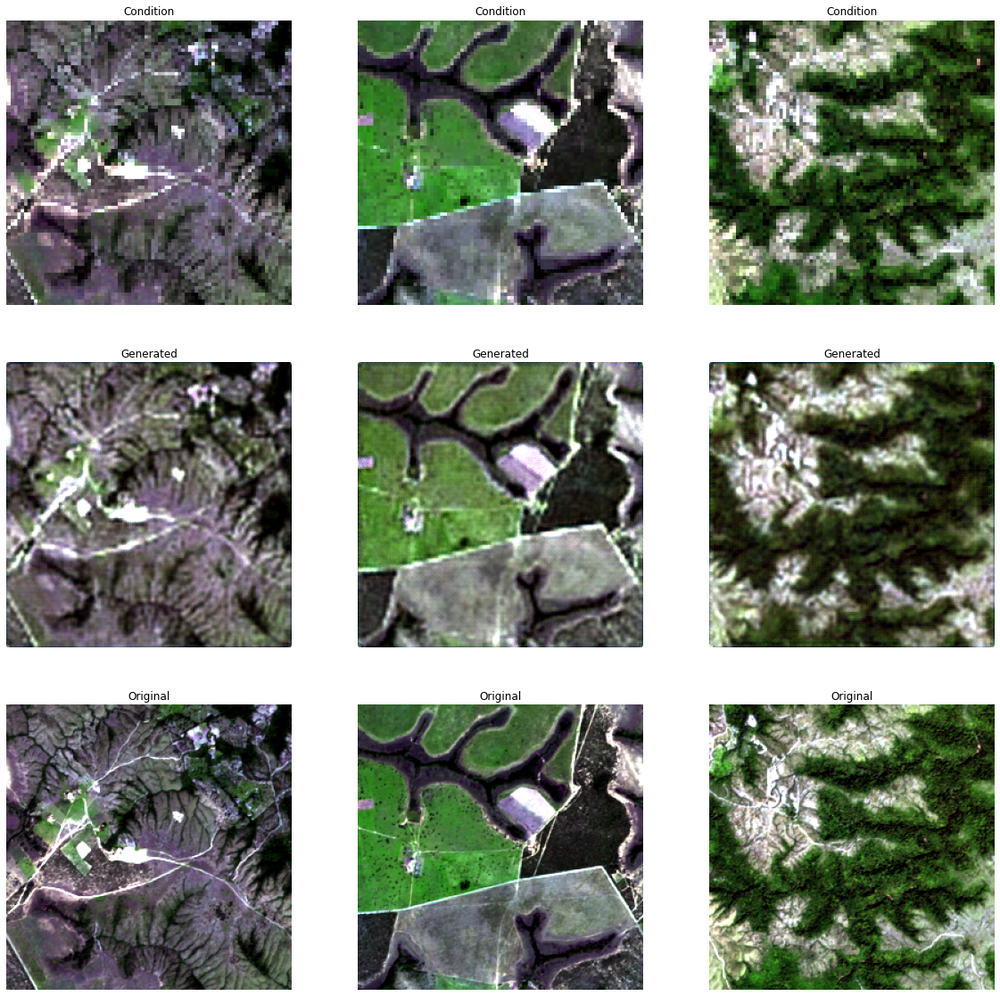

[Epoch 20] [Batch 0] [D1 loss: 0.060047] [D2 loss: 0.135129] [G loss: 2.019758]
[Epoch 20] [Batch 1] [D1 loss: 0.054702] [D2 loss: 0.031258] [G loss: 2.137234]
[Epoch 20] [Batch 2] [D1 loss: 0.039572] [D2 loss: 0.014023] [G loss: 1.567381]


In [ ]:
# load image data
image_shape = (256, 256, 6)

# define the models
d_model = define_discriminator(image_shape)
g_model = define_generator(image_shape)

# save or reload models
logs_dir = '/content/drive/MyDrive/Colab Notebooks Private/superresolution/logs'
if not os.path.exists(logs_dir):
    os.mkdir(logs_dir)

g_filename = '%s/g_model.h5' % (logs_dir)
d_filename = '%s/d_model.h5' % (logs_dir)

if os.path.exists(g_filename):
    g_model.load_model(g_filename)
    
if os.path.exists(d_filename):
    d_model.load_model(d_filename)

# define the composite model
gan_model = define_gan(g_model, d_model, image_shape)

# train model
train(d_model, g_model, gan_model, n_epochs=1000, n_batch=64, 
      logs_dir=logs_dir, d_filename=d_filename, g_filename=g_filename)